<a href="https://colab.research.google.com/github/shardulchavan/Time_Series_Forecasting/blob/main/Climate_TimeSeries_Forecasting.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt

In [3]:
new_climate_data=pd.read_csv("https://raw.githubusercontent.com/shardulchavan/Time_Series_Forecasting/main/Data/FAOSTAT_data_1-10-2022.csv")

When working with climate time series data, there are several steps you can follow to perform a thorough analysis:

1. Data Preparation: The first step is to prepare the data for analysis. This involves cleaning and organizing the data, and converting it into a time series format. You may need to address issues such as missing data, outliers, and inconsistent time intervals.

2. Exploratory Data Analysis (EDA): EDA involves visualizing the data to understand its underlying patterns and relationships. This can be done by plotting the time series data, examining summary statistics, and exploring the autocorrelation structure using ACF and PACF plots.

3. Time Series Modeling: Once you have a good understanding of the data, you can begin to develop time series models for forecasting. Common models used in climate time series analysis include ARIMA, SARIMA, and exponential smoothing. These models can be fit to the data and used to make forecasts for future time periods.

4. Model Evaluation: It is important to evaluate the accuracy of the time series models to determine how well they are able to forecast future values. This can be done by comparing the predicted values to the actual values, and calculating metrics such as mean absolute error (MAE) and root mean squared error (RMSE).

5. Interpretation and Communication: Finally, it is important to interpret the results of the analysis and communicate them effectively to stakeholders. This may involve creating visualizations and reports to help explain the key findings and implications of the analysis.

Overall, working with climate time series data requires careful attention to data preparation, exploratory data analysis, modeling, evaluation, and communication. By following these steps, you can gain valuable insights into the behavior of the climate and make accurate forecasts for future time periods.






In [4]:
new_climate_data.head()

,Domain Code,Domain,Area Code (FAO),Area,Element Code,Element,Months Code,Months,Year Code,Year,Unit,Value,Flag,Flag Description
0,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1961,1961,?C,0.746,Fc,Calculated data
1,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1962,1962,?C,0.009,Fc,Calculated data
2,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1963,1963,?C,2.695,Fc,Calculated data
3,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1964,1964,?C,-5.277,Fc,Calculated data
4,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1965,1965,?C,1.827,Fc,Calculated data


In [5]:
new_climate_data['Months Code']=new_climate_data['Months Code']<2013

In [6]:
new_climate_data=new_climate_data.dropna()

In [7]:
print(new_climate_data.shape)
new_climate_data.isnull().sum()

(222012, 14)


Domain Code         0
Domain              0
Area Code (FAO)     0
Area                0
Element Code        0
Element             0
Months Code         0
Months              0
Year Code           0
Year                0
Unit                0
Value               0
Flag                0
Flag Description    0
dtype: int64

### Data Imputation

Creating new NaN Values in data to test various imputation methods

In [8]:
new_climate_data1=new_climate_data.copy()
num_rows = 2000
rows = np.random.choice(new_climate_data.index, size=num_rows, replace=False)
# replace the selected entries with NaN values
new_climate_data.loc[rows, 'Value'] = np.nan

In [9]:
new_climate_data.isnull().sum()

Domain Code            0
Domain                 0
Area Code (FAO)        0
Area                   0
Element Code           0
Element                0
Months Code            0
Months                 0
Year Code              0
Year                   0
Unit                   0
Value               2000
Flag                   0
Flag Description       0
dtype: int64

In [10]:
new_climate_data['Value'] = pd.to_numeric(new_climate_data['Value'], errors='coerce')

In [11]:
new_climate_data['Value'].dtype

dtype('float64')

Data Imputation Methods for Time Series Data

In [12]:
new_climate_data['Mean_imputed_Value'] = new_climate_data['Value'].fillna(new_climate_data['Value'].mean())  # Mean imputation

In [13]:
new_climate_data['FwdFill_Imputed_Value']  =new_climate_data['Value'] .fillna(method='ffill')  # Forward fill

In [14]:
new_climate_data['linearinterpolate_Imputed_Value'] = new_climate_data['Value'].interpolate(method='linear') # Linear Interpolation

In [15]:
new_climate_data['MA_imputed'] = new_climate_data['Value'].rolling(window=4, min_periods=1, center=True).mean() # Moving average

To compare different imputation methods, you can calculate various evaluation metrics to compare the imputed values to the true values. Here are a few commonly used metrics:

1. Root Mean Squared Error (RMSE): This measures the average difference between the imputed values and the true values, with larger differences weighted more heavily. Lower RMSE values indicate better imputation accuracy.

2. Mean Absolute Error (MAE): This measures the average absolute difference between the imputed values and the true values, without weighting. Lower MAE values indicate better imputation accuracy.

3. Mean Absolute Percentage Error (MAPE): This measures the average percentage difference between the imputed values and the true values. Lower MAPE values indicate better imputation accuracy.

4. Correlation Coefficient (r): This measures the strength and direction of the linear relationship between the imputed values and the true values. Higher correlation coefficients indicate better imputation accuracy.

In [16]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
from scipy.stats import pearsonr
rmse = pd.Series({
    'ffill': np.sqrt(mean_squared_error(new_climate_data1['Value'], new_climate_data['FwdFill_Imputed_Value'])),
    'mean': np.sqrt(mean_squared_error(new_climate_data1['Value'], new_climate_data['Mean_imputed_Value'])),
    'moving_average': np.sqrt(mean_squared_error(new_climate_data1['Value'], new_climate_data['MA_imputed'])),
    'linear_interpolation': np.sqrt(mean_squared_error(new_climate_data1['Value'],new_climate_data['linearinterpolate_Imputed_Value']))
})
mae = pd.Series({
    'ffill': mean_absolute_error(new_climate_data1['Value'], new_climate_data['FwdFill_Imputed_Value']),
    'mean': mean_absolute_error(new_climate_data1['Value'], new_climate_data['Mean_imputed_Value']),
    'moving_average': mean_absolute_error(new_climate_data1['Value'], new_climate_data['MA_imputed']),
    'linear_interpolation': mean_absolute_error(new_climate_data1['Value'], new_climate_data['linearinterpolate_Imputed_Value'])
})
mape = pd.Series({
    'ffill': np.mean(np.abs((new_climate_data1['Value']-new_climate_data['FwdFill_Imputed_Value']) / new_climate_data1['Value'])) * 100,
    'mean': np.mean(np.abs((new_climate_data1['Value'] - new_climate_data['Mean_imputed_Value']) / new_climate_data1['Value'])) * 100,
    'moving_average': np.mean(np.abs((new_climate_data1['Value'] - new_climate_data['MA_imputed']) / new_climate_data1['Value'])) * 100,
    'linear_interpolation': np.mean(np.abs((new_climate_data1['Value'] - new_climate_data['linearinterpolate_Imputed_Value']) / new_climate_data1['Value'])) * 100
})
r = pd.Series({
    'ffill': pearsonr(new_climate_data1['Value'],new_climate_data['FwdFill_Imputed_Value'])[0],
    'mean': pearsonr(new_climate_data1['Value'], new_climate_data['Mean_imputed_Value'])[0],
})

In [17]:
print(rmse.idxmin(),rmse.min())
print(mae.idxmin(),mae.min())
print(mape.idxmin(),mape.min())
print(r.idxmax(),r.max())

linear_interpolation 0.10019008517773531
linear_interpolation 0.0063444566059492275
ffill inf
mean 0.9949616215125798


From above results Linear Interpolation works better for imputing missing values 

In [18]:
imputed_data=pd.read_csv("https://raw.githubusercontent.com/shardulchavan/Time_Series_Forecasting/main/Data/FAOSTAT_data_1-10-2022.csv")

In [19]:
imputed_data.isnull().sum()

Domain Code            0
Domain                 0
Area Code (FAO)        0
Area                   0
Element Code           0
Element                0
Months Code            0
Months                 0
Year Code              0
Year                   0
Unit                   0
Value               7913
Flag                   0
Flag Description       0
dtype: int64

In [20]:
imputed_data['Value'] = imputed_data['Value'].interpolate(method='linear')
imputed_data.isnull().sum()


Domain Code         0
Domain              0
Area Code (FAO)     0
Area                0
Element Code        0
Element             0
Months Code         0
Months              0
Year Code           0
Year                0
Unit                0
Value               0
Flag                0
Flag Description    0
dtype: int64

In [21]:
imputed_data.describe()

,Area Code (FAO),Element Code,Months Code,Year Code,Year,Value
count,229925.000000,229925.0,229925.000000,229925.000000,229925.000000,229925.000000
mean,130.647689,7271.0,7009.882353,1991.306248,1991.306248,0.484196
std,76.809008,0.0,6.037955,17.333252,17.333252,1.024899
min,1.000000,7271.0,7001.000000,1961.000000,1961.000000,-9.303000
25%,64.000000,7271.0,7005.000000,1976.000000,1976.000000,-0.072000
50%,131.000000,7271.0,7009.000000,1992.000000,1992.000000,0.406000
75%,194.000000,7271.0,7016.000000,2006.000000,2006.000000,0.982000
max,351.000000,7271.0,7020.000000,2020.000000,2020.000000,11.759000


In [22]:
print(imputed_data.shape)
imputed_data.head()

(229925, 14)


,Domain Code,Domain,Area Code (FAO),Area,Element Code,Element,Months Code,Months,Year Code,Year,Unit,Value,Flag,Flag Description
0,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1961,1961,?C,0.746,Fc,Calculated data
1,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1962,1962,?C,0.009,Fc,Calculated data
2,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1963,1963,?C,2.695,Fc,Calculated data
3,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1964,1964,?C,-5.277,Fc,Calculated data
4,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1965,1965,?C,1.827,Fc,Calculated data


When dealing with time series data, it is important to ensure that the data is properly indexed based on the time of the instance in the dataset. In order to achieve this, we need to encode the months into a numerical form and create a new date column that includes the year, month, and day in a datetime format.

In [23]:
imputed_data['Months'].unique()

array(['January', 'February', 'March', 'April', 'May', 'June', 'July',
       'August', 'September', 'October', 'November', 'December',
       'Dec?Jan?Feb', 'Mar?Apr?May', 'Jun?Jul?Aug', 'Sep?Oct?Nov',
       'Meteorological year'], dtype=object)

In [24]:
map_encoding={'January':1,'February':2,'March':3,'April':4,'May':5,'June':6,'July':7,'August':8,'September':9, 'October':10, 'November':11, 'December':12}
map_encoding
imputed_data['new_Months_Code']=imputed_data['Months'].map(map_encoding)

To accomplish this, we begin by converting the month names in the dataset into numerical values. We then create a new column named 'date' that combines the year, month, and day columns into a single datetime object. This process ensures that the data is properly indexed and allows us to perform time-based analyses such as trend and seasonality analysis.

In [25]:
imputed_data['new_Months_Code'].unique()
imputed_data = imputed_data.dropna()
# Check for missing values
print(imputed_data.isnull().sum())

Domain Code         0
Domain              0
Area Code (FAO)     0
Area                0
Element Code        0
Element             0
Months Code         0
Months              0
Year Code           0
Year                0
Unit                0
Value               0
Flag                0
Flag Description    0
new_Months_Code     0
dtype: int64


In [26]:
imputed_data['new_Months_Code'].dtype
imputed_data['new_Months_Code']=imputed_data['new_Months_Code'].astype(int)
imputed_data['new_Months_Code'].dtype

dtype('int64')

In [27]:
imputed_data['date'] = pd.to_datetime(imputed_data["Year"].astype(str) + "-" + imputed_data["new_Months_Code"].astype(str) + "-01")
imputed_data.head()

,Domain Code,Domain,Area Code (FAO),Area,Element Code,Element,Months Code,Months,Year Code,Year,Unit,Value,Flag,Flag Description,new_Months_Code,date
0,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1961,1961,?C,0.746,Fc,Calculated data,1,1961-01-01
1,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1962,1962,?C,0.009,Fc,Calculated data,1,1962-01-01
2,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1963,1963,?C,2.695,Fc,Calculated data,1,1963-01-01
3,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1964,1964,?C,-5.277,Fc,Calculated data,1,1964-01-01
4,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1965,1965,?C,1.827,Fc,Calculated data,1,1965-01-01


In [28]:
# sort values of date column
climate_data=imputed_data.sort_values('date',ascending=True).reset_index(drop=True)
# Set the date column as the index
climate_data.set_index('date', inplace=False)

,Domain Code,Domain,Area Code (FAO),Area,Element Code,Element,Months Code,Months,Year Code,Year,Unit,Value,Flag,Flag Description,new_Months_Code
date,,,,,,,,,,,,,,,
1961-01-01,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1961,1961,?C,0.746000,Fc,Calculated data,1
1961-01-01,ET,Temperature change,131,Malaysia,7271,Temperature change,7001,January,1961,1961,?C,-0.152000,Fc,Calculated data,1
1961-01-01,ET,Temperature change,130,Malawi,7271,Temperature change,7001,January,1961,1961,?C,0.235000,Fc,Calculated data,1
1961-01-01,ET,Temperature change,129,Madagascar,7271,Temperature change,7001,January,1961,1961,?C,0.238000,Fc,Calculated data,1
1961-01-01,ET,Temperature change,229,United Kingdom of Great Britain and Northern I...,7271,Temperature change,7001,January,1961,1961,?C,-0.054000,Fc,Calculated data,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-01,ET,Temperature change,99,Iceland,7271,Temperature change,7012,December,2020,2020,?C,1.259000,Fc,Calculated data,12
2020-12-01,ET,Temperature change,97,Hungary,7271,Temperature change,7012,December,2020,2020,?C,3.210000,Fc,Calculated data,12
2020-12-01,ET,Temperature change,162,Norway,7271,Temperature change,7012,December,2020,2020,?C,4.188000,Fc,Calculated data,12


We proceed further with only necessary data

In [29]:
final_climate_data=climate_data.loc[:,['Area Code (FAO)','Area','Months','Year','Value','date']]
final_climate_data.set_index('date', inplace=True)

In [30]:
final_climate_data.to_csv('Climate_data1.csv', index=True)

In [31]:
final_climate_data.head()

,Area Code (FAO),Area,Months,Year,Value
date,,,,,
1961-01-01,2,Afghanistan,January,1961,0.746
1961-01-01,131,Malaysia,January,1961,-0.152
1961-01-01,130,Malawi,January,1961,0.235
1961-01-01,129,Madagascar,January,1961,0.238
1961-01-01,229,United Kingdom of Great Britain and Northern I...,January,1961,-0.054


In [32]:
final_climate_data.tail()

,Area Code (FAO),Area,Months,Year,Value
date,,,,,
2020-12-01,99,Iceland,December,2020,1.259000
2020-12-01,97,Hungary,December,2020,3.210000
2020-12-01,162,Norway,December,2020,4.188000
2020-12-01,160,Niue,December,2020,0.564552
2020-12-01,181,Zimbabwe,December,2020,-0.146000


## **Visualizing Time Series Data**

Text(0.5, 0, 'Temperature in Celsius')

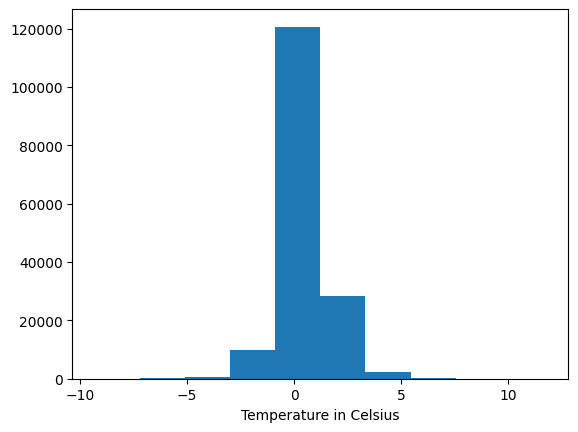

In [33]:
import matplotlib.pyplot as plt

# Create a histogram of a Temperature values column
plt.hist(final_climate_data['Value'])
plt.xlabel('Temperature in Celsius')

In [34]:
import pandas as pd
import plotly.express as px

# Calculate the average temperature by year and region
avg_temp_by_year_region = final_climate_data.groupby(['Year', 'Area'])['Value'].mean().reset_index()

# Create a line chart with multiple lines using plotly
fig = px.line(avg_temp_by_year_region, x='Year', y='Value', color='Area', labels={'Year': 'Year', 'AvgTemperatureC': 'Value', 'Region': 'Area'}, title='Yearly Average Temperature by Region')

# Show the chart
fig.show()


In [35]:
import plotly.graph_objs as go
import pandas as pd

# Load data
data = final_climate_data

# Create choropleth map
fig = go.Figure(data=go.Choropleth(
    locations=data['Area'], # Geographical region
    z=data['Value'], # Temperature
    locationmode='country names',
    colorscale='Viridis', # Color scale
    colorbar_title = "Temperature (°C)",
))

# Set layout
fig.update_layout(
    title_text='Temperature by Region',
    geo=dict(
        showframe=False,
        showcoastlines=False,
        projection_type='equirectangular'
    ),
    updatemenus=[dict(
        type='buttons',
        buttons=[dict(label='Play',
                      method='animate',
                      args=[None,
                            {'frame': {'duration': 1000, 'redraw': False},
                             'fromcurrent': True, 'transition': {'duration': 0}}
                            ]),
                 dict(label='Pause',
                      method='animate',
                      args=[[None], {'frame': {'duration': 0, 'redraw': False},
                                     'mode': 'immediate',
                                     'transition': {'duration': 0}}])
                ]
    )]
)

# Create frames for animation
frames = [go.Frame(data=[go.Choropleth(
    locations=data['Area'],
    z=data[str(year)],
    locationmode='country names',
    colorscale='Viridis',
    colorbar_title = "Temperature (°C)",
    )],
    name=str(year)
    ) for year in range(2000, 2010)]

# Add frames to figure
fig.frames = frames

# Show figure
fig.show()


<ipython-input-35-f9f7c58c27b8>:44: FutureWarning:

Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.



In [36]:
import plotly.graph_objs as go
import pandas as pd

# Load data
data = final_climate_data

# Create 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=data['Year'], # Year
    y=data['Area'], # Area
    z=data['Value'], # Temperature
    mode='markers',
    marker=dict(
        size=10,
        color=data['Value'], # Color
        colorscale='Viridis', # Color scale
        opacity=0.8
    )
)])

# Set layout
fig.update_layout(
    scene=dict(
        xaxis_title='Year',
        yaxis_title='Area',
        zaxis_title='Temperature (°C)'),
    title='Temperature by Area and Year'
)

# Show figure
fig.show()


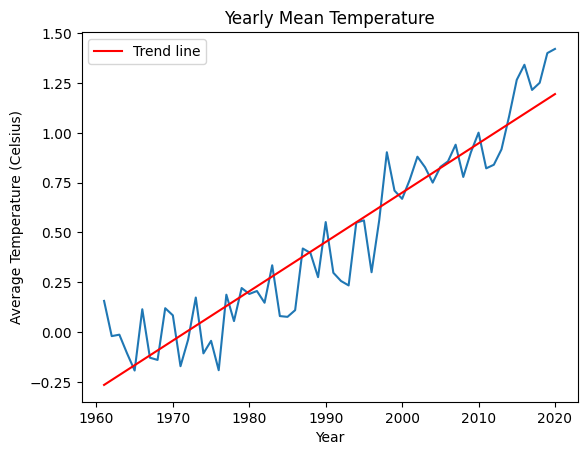

In [37]:
from scipy.stats import linregress
from matplotlib import pyplot as plt
yearly_mean = final_climate_data.groupby('Year')['Value'].mean()

# Fit a linear regression model to the data
slope, intercept, r_value, p_value, std_err = linregress(yearly_mean.index, yearly_mean.values)

# Plot the yearly mean temperatures in a line chart

plt.plot(yearly_mean.index, yearly_mean.values)
plt.xlabel('Year')
plt.ylabel('Average Temperature (Celsius)')
plt.title('Yearly Mean Temperature')

# Plot the regression line over the line chart
plt.plot(yearly_mean.index, slope * yearly_mean.index + intercept, color='red', label='Trend line')

plt.legend()
plt.show()


In [38]:
monthly_mean = final_climate_data.groupby('date')['Value'].mean()
monthly_mean

date
1961-01-01    0.122913
1961-02-01    0.256498
1961-03-01    0.298407
1961-04-01    0.447664
1961-05-01    0.260352
                ...   
2020-08-01    1.470535
2020-09-01    1.452489
2020-10-01    1.181958
2020-11-01    1.298754
2020-12-01    1.266206
Name: Value, Length: 720, dtype: float64

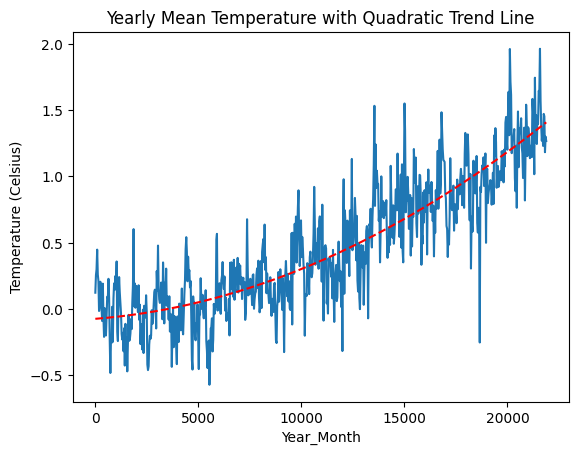

In [39]:
# Fit a quadratic polynomial trend line using numpy's polyfit() function
X=(monthly_mean.index - monthly_mean.index.min()).days 
trend_coeffs = np.polyfit(X, monthly_mean.values, 2)
trend_line = np.polyval(trend_coeffs, X)

# Create a line chart using matplotlib
plt.plot(X, monthly_mean.values)
plt.plot(X, trend_line, 'r--')

# Add labels and title to the chart
plt.xlabel('Year_Month')
plt.ylabel('Temperature (Celsius)')
plt.title('Yearly Mean Temperature with Quadratic Trend Line')

# Display the chart
plt.show()

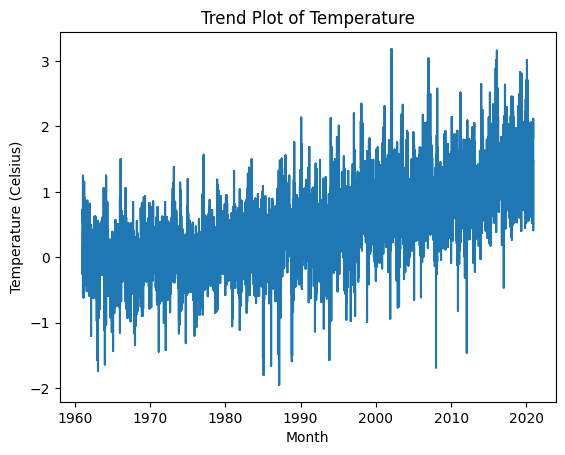

In [40]:
from statsmodels.tsa.seasonal import seasonal_decompose

decomposition = seasonal_decompose(final_climate_data['Value'], model='additive',period=12)
trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid


plt.plot(trend)
plt.xlabel('Month')
plt.ylabel('Temperature (Celsius)')
plt.title('Trend Plot of Temperature')
plt.show()


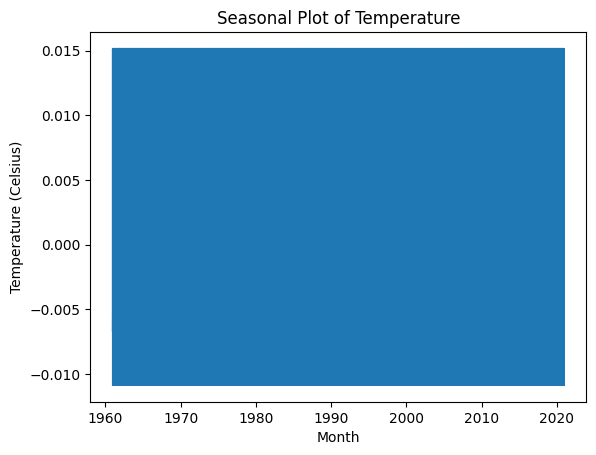

In [41]:

plt.plot(seasonal)
plt.xlabel('Month')
plt.ylabel('Temperature (Celsius)')
plt.title('Seasonal Plot of Temperature')
plt.show()

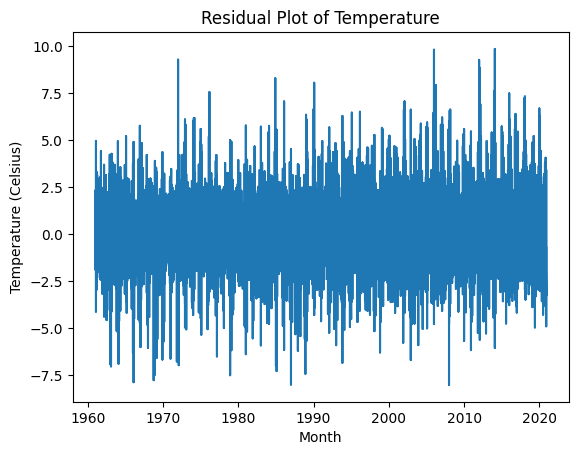

In [42]:

plt.plot(residual)
plt.xlabel('Month')
plt.ylabel('Temperature (Celsius)')
plt.title('Residual Plot of Temperature')
plt.show()

# Stationarity Testing

## What is Autocorrelation

Autocorrelation is an important statistical tool in time series analysis because it can help identify patterns and relationships between observations at different lags. Specifically, autocorrelation measures the correlation between a time series and a lagged version of itself.

It is a useful tool for understanding the properties of time series data and for building models that can be used for forecasting and other applications in time series analysis.

Autocorrelation formula:

$$
\rho_k = \frac{\gamma_k}{\gamma_0}
$$


# How to Choose Autocorrelation Technique

The choice of autocorrelation technique to use depends on several characteristics of the time series data, including:

1. Type of time series: Is the time series stationary or non-stationary? A stationary time series has constant statistical properties over time, while a non-stationary time series has changing statistical properties. The type of time series can influence the choice of autocorrelation technique.

2. Seasonality: Does the time series exhibit seasonality or periodicity? If so, methods such as seasonal autoregressive integrated moving average (SARIMA) models or Fourier analysis may be appropriate.

3. Time series length: How long is the time series? Short time series may require simpler models or techniques, while longer time series may require more complex models or techniques to capture the autocorrelation.

4. Strength and persistence of autocorrelation: How strong and persistent is the autocorrelation in the time series? If the autocorrelation is weak, simple methods such as the autocorrelation function (ACF) may suffice. If the autocorrelation is strong, more advanced methods such as wavelet analysis or autoregressive (AR) models may be required.

5. Level of noise: How noisy is the time series data? If the time series data contains a lot of noise or random variation, simpler methods such as ACF may be sufficient, while more complex models such as ARIMA or wavelet analysis may be needed if the noise is non-random and exhibits structure.

6. Purpose of analysis: What is the purpose of the autocorrelation analysis? Different techniques may be appropriate depending on whether the goal is to forecast future values, identify periodicity, or detect unusual events.

Overall, the choice of autocorrelation technique should be based on a careful analysis of the specific characteristics of the time series data and the goals of the analysis. It's often a good idea to try several different techniques and compare their results to choose the best one for the given situation.







#Correlogram
A correlogram, also known as an autocorrelation plot or ACF plot, is a graphical tool used to visualize the autocorrelation function (ACF) of a time series. The correlogram displays the autocorrelation coefficients of a time series at different lags on the y-axis, with the lag values themselves plotted on the x-axis.

The correlogram is a useful tool in time series analysis because it can help identify the presence of patterns in the time series that repeat at regular intervals, known as seasonality. It can also be used to determine the appropriate order of autoregressive (AR) and moving average (MA) models, which are commonly used to model time series data.

In a correlogram, the autocorrelation coefficients are plotted as bars or dots, with error bars indicating the uncertainty in the estimates. The error bars are calculated based on the assumption that the autocorrelation coefficients are normally distributed with a mean of zero and a variance that depends on the sample size and the autocorrelation coefficient itself.

The correlogram can be used to visualize the autocorrelation function of a single time series, or to compare the autocorrelation functions of multiple time series. It is a widely used tool in the field of time series analysis and is supported by many software packages and programming languages, including R and Python.

In [43]:
import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
acf_data = sm.tsa.stattools.acf(final_climate_data['Value'], nlags=30)
pacf_data = sm.tsa.stattools.pacf(final_climate_data['Value'], nlags=30)

# How Does Stationarity affect Autocorrelation test

1. Stationarity can affect autocorrelation. Autocorrelation is a measure of the correlation between a time series and a lagged version of itself. if a time series is stationary, the autocorrelation function (ACF) should decay quickly to zero as the lag increases. If the ACF decays slowly or does not decay at all, this may indicate that the time series is non-stationary, or that the model being used to fit the data is inadequate.


2. For a stationary time series, the partial autocorrelation function (PACF) will converge to zero for all lags beyond the order of the autoregressive (AR) process. This means that the PACF can be used to estimate the order of an AR model for a stationary time series.

However, for a non-stationary time series, the PACF may not converge to zero, even for large lags. This is because the relationship between the observations at different lags may be affected by changes in the mean, variance, or other properties of the time series over time.

/usr/local/lib/python3.9/dist-packages/statsmodels/graphics/tsaplots.py:348: FutureWarning:

The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.



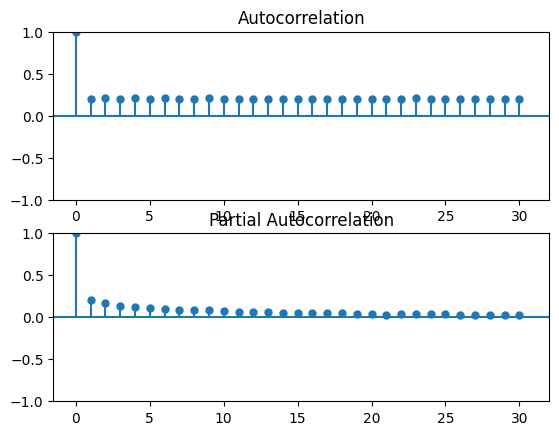

In [44]:
# Create correlogram
fig, (ax1, ax2) = plt.subplots(2, 1)
plot_acf(final_climate_data['Value'], lags=30, ax=ax1)
plot_pacf(final_climate_data['Value'], lags=30, ax=ax2)

plt.show()

However in our case, the ACF does not change over time and remains close to zero, this could indicate that the time series is stationary. However, it is important to note that other statistical tests may be necessary to confirm stationarity, such as unit root tests like the Augmented Dickey-Fuller (ADF) test or the Kwiatkowski-Phillips-Schmidt-Shin (KPSS) test.

### Augmented Dickey-Fuller (ADF) test 

In [45]:
from statsmodels.tsa.stattools import adfuller
# Perform ADF test
result = adfuller(final_climate_data['Value'])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

# Interpret the results
if result[1] <= 0.05:
    print('The time series is stationary.')
else:
    print('The time series is non-stationary.')

ADF Statistic: -11.120072
p-value: 0.000000
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567
The time series is stationary.


Based on the given results of the Augmented Dickey-Fuller (ADF) test, the ADF statistic of -11.120072 is lower than the critical values at the 1%, 5%, and 10% levels. Additionally, the p-value of 0.000000 indicates that the null hypothesis of non-stationarity can be rejected with a high level of confidence.

Therefore, we can conclude that the time series being tested is stationary. Specifically, the ADF test has provided strong evidence that the trend and/or seasonality in the data has been removed, and that the series is likely to exhibit a constant mean and variance over time.


## Kwiatkowski-Phillips-Schmidt-Shin (KPSS) test

In [46]:
from statsmodels.tsa.stattools import adfuller, kpss

result_kpss = kpss(final_climate_data['Value'])
print('\nKPSS Statistic: %f' % result_kpss[0])
print('p-value: %f' % result_kpss[1])
print('Critical Values:')
for key, value in result_kpss[3].items():
    print('\t%s: %.3f' % (key, value))



KPSS Statistic: 59.434158
p-value: 0.010000
Critical Values:
	10%: 0.347
	5%: 0.463
	2.5%: 0.574
	1%: 0.739


/usr/local/lib/python3.9/dist-packages/statsmodels/tsa/stattools.py:2018: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.




# what is AutoRegressive 

Autoregressive (AR) is a class of time series models that use past values of a time series to predict future values. In an autoregressive model, the dependent variable (i.e., the time series of interest) is modeled as a linear function of one or more past values of itself.

The order of an autoregressive model refers to the number of past values used to predict future values. For example, an AR(1) model uses only one past value, while an AR(2) model uses two past values, and so on. The order of the model can be determined using statistical techniques such as the partial autocorrelation function or information criteria like AIC or BIC.

Autoregressive models are widely used in time series analysis, and they can be extended to include other features such as moving average terms, seasonal effects, and exogenous variables. These models can be estimated using various methods, including maximum likelihood estimation and least squares estimation.

date
2020-12-01    1.285801
2020-12-01    1.285801
2020-12-01    1.285801
2020-12-01    1.285801
2020-12-01    1.285801
                ...   
2020-12-01    1.285801
2020-12-01    1.285801
2020-12-01    1.285801
2020-12-01    1.285801
2020-12-01    1.285801
Length: 120, dtype: float64


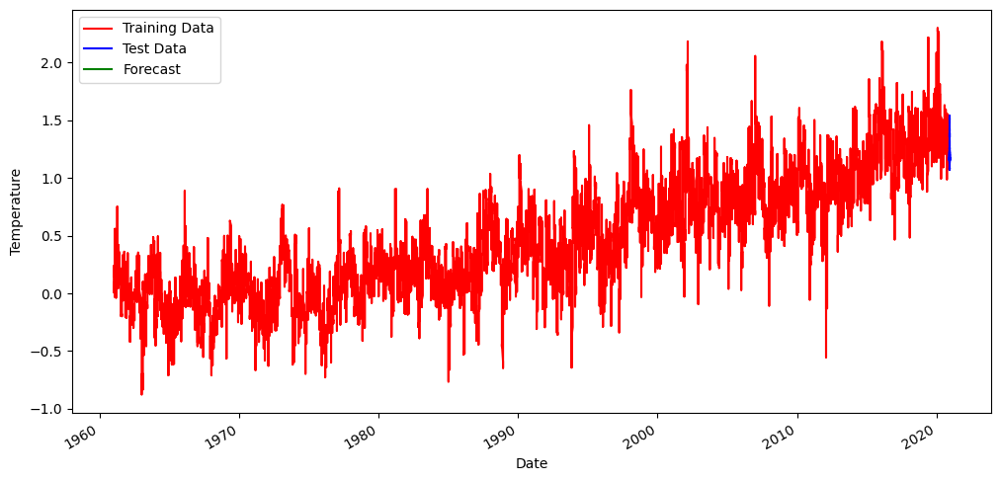

In [75]:
import pandas as pd
import matplotlib.pyplot as plt

# Load data into a Pandas DataFrame
data = final_climate_data

# Calculate 12-month moving average for temperature
temp_ma = data['Value'].rolling(window=60).mean()
area_ma = data['Area Code (FAO)'].rolling(window=60).mean()

# Split data into training and testing sets
train_data = temp_ma[:-120]
test_data = temp_ma[-120:]

# Create a forecast using the last 12 months of the training data
forecast = pd.Series(train_data.tail(60).mean(), index=test_data.index)
print(forecast)
# Plot original data and forecast
fig, ax = plt.subplots(figsize=(12, 6))
train_data.plot(ax=ax, color='red')
test_data.plot(ax=ax, color='blue')
forecast.plot(ax=ax, color='green')
ax.set_ylabel('Temperature')
ax.set_xlabel('Date')
ax.legend(['Training Data', 'Test Data', 'Forecast'])
plt.show()



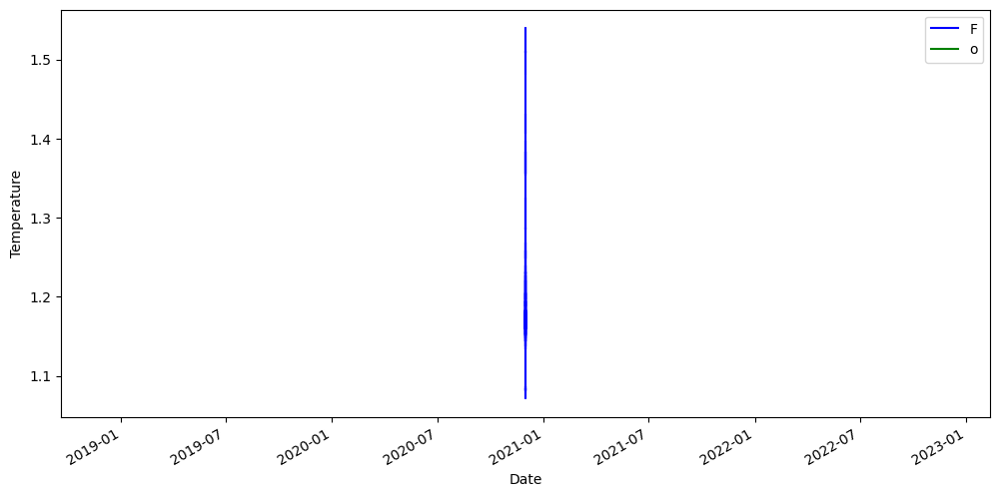

In [76]:
fig, ax = plt.subplots(figsize=(12, 6))
# region_data.plot(ax=ax, color='red')
test_data.plot(ax=ax, color='blue')
forecast.plot(ax=ax, color='green')
ax.set_ylabel('Temperature')
ax.set_xlabel('Date')
ax.legend('Forecast')
plt.show()

In [80]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error

# Load data into a Pandas DataFrame
data = final_climate_data

# Extract temperature data for a specific region
region_data = data.loc[data['Area'] == 'Malaysia']['Value']

# Split data into training and testing sets
train_data = region_data[:-24]
test_data = region_data[-24:]



/usr/local/lib/python3.9/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency MS will be used.

/usr/local/lib/python3.9/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency MS will be used.

/usr/local/lib/python3.9/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency MS will be used.



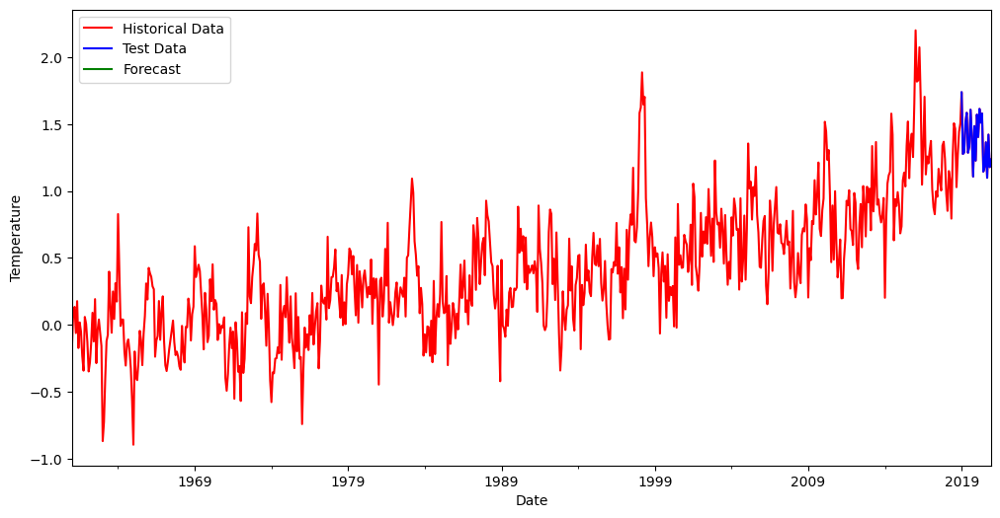

In [82]:
# Fit ARIMA model to training data
ARIMA_model = ARIMA(train_data, order=(1, 1, 1))
model_fit = ARIMA_model.fit()

# Generate predictions for test data using fitted model
predictions = model_fit.forecast(steps=24)

# Calculate root mean squared error of predictions
rmse = np.sqrt(mean_squared_error(test_data, predictions))

# Plot original data and forecast
fig, ax = plt.subplots(figsize=(12, 6))
region_data.plot(ax=ax, color='red')
test_data.plot(ax=ax, color='blue')
plt.plot(test_data.index, predictions, color='green')
ax.set_ylabel('Temperature')
ax.set_xlabel('Date')
ax.legend(['Historical Data', 'Test Data', 'Forecast'])
plt.show()


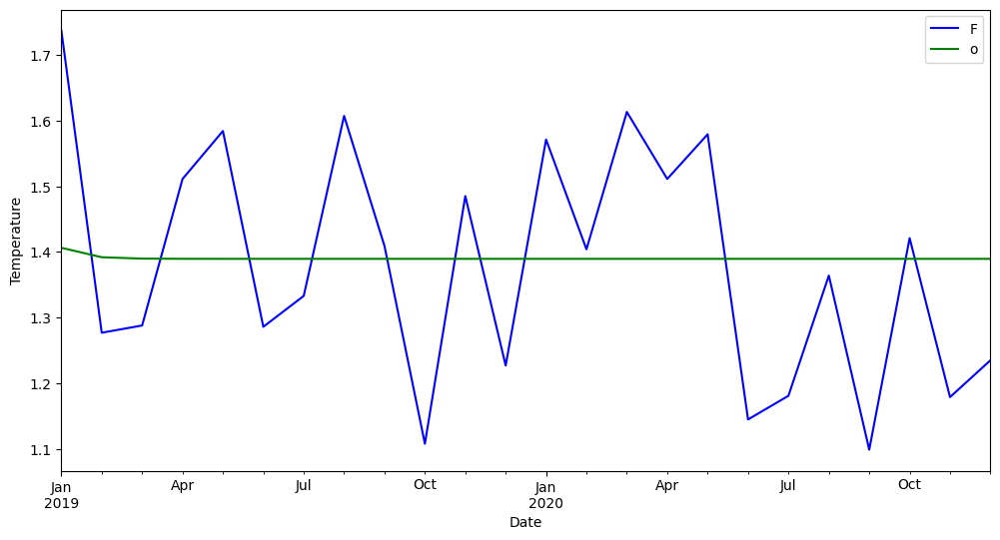

In [83]:
fig, ax = plt.subplots(figsize=(12, 6))
# region_data.plot(ax=ax, color='red')
test_data.plot(ax=ax, color='blue')
predictions.plot(ax=ax, color='green')
ax.set_ylabel('Temperature')
ax.set_xlabel('Date')
ax.legend('Forecast')
plt.show()

/usr/local/lib/python3.9/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency MS will be used.

/usr/local/lib/python3.9/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency MS will be used.



                                     SARIMAX Results                                      
Dep. Variable:                              Value   No. Observations:                  696
Model:             SARIMAX(1, 1, 1)x(1, 0, 1, 12)   Log Likelihood                 -40.564
Date:                            Mon, 10 Apr 2023   AIC                             91.128
Time:                                    20:51:56   BIC                            113.847
Sample:                                01-01-1961   HQIC                            99.913
                                     - 12-01-2018                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1575      0.068      2.306      0.021       0.024       0.291
ma.L1         -0.6599      0.052   

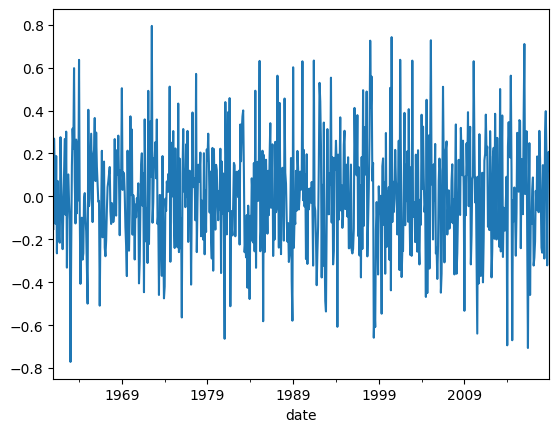

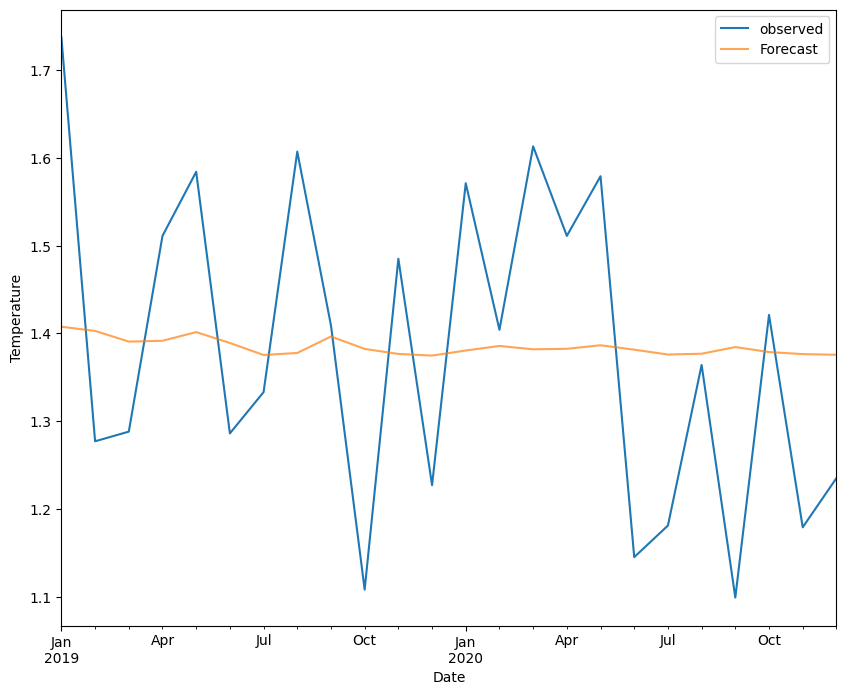

In [85]:
from statsmodels.tsa.statespace.sarimax import SARIMAX
# Fit SARIMA model
SARIMA_model = SARIMAX(train_data, order=(1, 1, 1), seasonal_order=(1, 0, 1, 12))
results = SARIMA_model.fit()

# Print model summary
print(results.summary())

# Plot model residuals
results.resid.plot()
plt.show()

# Plot forecasted values
forecast = results.get_forecast(steps=24)
forecast_ci = forecast.conf_int()
ax = test_data.plot(label='observed')
forecast.predicted_mean.plot(ax=ax, label='Forecast', alpha=.7, figsize=(10, 8))

ax.set_xlabel('Date')
ax.set_ylabel('Temperature')
plt.legend()
plt.show()

References

Hyndman, R. J., & Athanasopoulos, G. (2018). Forecasting: principles and practice. OTexts.

Statistical Modeling of Time Series Data Part 2: Exploratory Data Analysis by Towards AI. Available at: https://towardsai.net/p/data-visualization/statistical-modeling-of-time-series-data-part-2-exploratory-data-analysis

## Quiz Questions

1. Which of the following is a common approach for forecasting time series data?

A) Regression analysis

B) Principal component analysis

C) Cluster analysis

D) Time series analysis


2. What is the purpose of exploratory data analysis (EDA) in time series forecasting?

A) To clean and organize the data

B) To fit a time series model to the data

C) To evaluate the accuracy of the model

D) To understand the underlying patterns and relationships in the data


3. Which of the following is NOT a common time series model used for forecasting?

A) Linear regression

B) ARIMA

C) SARIMA

D) Exponential smoothing

4. What is the difference between stationary and non-stationary time series data?

A) Stationary data has a constant mean and variance over time, while non-stationary data does not.

B) Stationary data has a linear trend over time, while non-stationary data does not.

C) Stationary data has seasonality, while non-stationary data does not.

D) Stationary data has a constant variance over time, while non-stationary data does not.


5. Which of the following is a technique used to evaluate the accuracy of a time series model?

A) Principal component analysis

B) Cluster analysis

C) Cross-validation

D) Principal component regression


6. What is the purpose of the autocorrelation function (ACF) plot in time series analysis?

A) To detect outliers in the data

B) To identify the order of the ARIMA model

C) To evaluate the accuracy of the model

D) To understand the correlation between the data and its lags


7. Which of the following is NOT a common approach for dealing with missing data in time series analysis?

A) Forward filling

B) Backward filling

C) Interpolation

D) Dropping the missing data


8. Which of the following is NOT a common type of time series data pattern?

A) Trend

B) Seasonality

C) Noise

D) Clustering


9. What is the purpose of differencing in time series analysis?
 
A) To remove trend and seasonality from the data
 
B) To interpolate missing data

C) To identify the order of the ARIMA model

D) To evaluate the accuracy of the model


10. Which of the following is a common approach for selecting the best ARIMA model for time series forecasting?

A) Grid search

B) Random search

C) Cross-validation

D) All of the above



#Answers

D) Time series analysis

D) To understand the underlying patterns and relationships in the data

A) Linear regression

A) Stationary data has a constant mean and variance over time, while non-stationary data does not.

C) Cross-validation

B) To identify the order of the ARIMA model

D) Dropping the missing data

D) Clustering

A) To remove trend and seasonality from the data

D) All of the above



